In [43]:
import json
import os
from pathlib import Path
from PIL import Image
import pandas as pd
from pandas import json_normalize
import random
import re

import numpy as np
import torch
import torchvision
from torch import nn
from torch.utils.data import DataLoader
from torchvision.io import read_image
from torch.utils.data import Dataset
from torchvision import datasets
from torchvision.transforms import ToTensor
import torchvision.transforms as transforms

import matplotlib.pyplot as plt

# Load the SDK
import lyft_dataset_sdk
from lyft_dataset_sdk.lyftdataset import LyftDataset, LyftDatasetExplorer, Quaternion, view_points
from lyft_dataset_sdk.utils.data_classes import LidarPointCloud
from lyft_dataset_sdk.utils.geometry_utils import BoxVisibility, box_in_image, view_points

In [2]:
pd.set_option("display.max_colwidth", None)

# Read in some data

In [3]:
# data_path = r"S:\MADS\Capstone\3d-object-detection-for-autonomous-vehicles"
data_path = Path(r"S:\MADS\Capstone\3d-object-detection-for-autonomous-vehicles")
json_path = r"S:\MADS\Capstone\3d-object-detection-for-autonomous-vehicles\data"
lyftdata = LyftDataset(data_path=data_path, json_path=json_path, verbose=True)

9 category,
18 attribute,
4 visibility,
18421 instance,
10 sensor,
148 calibrated_sensor,
177789 ego_pose,
180 log,
180 scene,
22680 sample,
189504 sample_data,
638179 sample_annotation,
1 map,
Done loading in 8.3 seconds.
Reverse indexing ...
Done reverse indexing in 2.8 seconds.


In [4]:
lyftdata_tables = lyftdata.table_names

table_record_counts = {}
for table in lyftdata_tables:
    table_record_counts[table] = len(getattr(lyftdata, table))

print(sum(table_record_counts.values()))
table_record_counts

1047123


{'category': 9,
 'attribute': 18,
 'visibility': 4,
 'instance': 18421,
 'sensor': 10,
 'calibrated_sensor': 148,
 'ego_pose': 177789,
 'log': 180,
 'scene': 180,
 'sample': 22680,
 'sample_data': 189504,
 'sample_annotation': 638179,
 'map': 1}

In [5]:
lyftdata.get('attribute', lyftdata.sample_annotation[0]['attribute_tokens'][0])

{'description': '',
 'token': '1ba8c9a8bda54423fa710b0af1441d849ecca8ed7b7f9393ba1794afe4aa6aa2',
 'name': 'object_action_stopped'}

In [6]:
lyftdata.get('sample_data', 'bf374e60b6a1b0b9d4c0e3cf9e92b1f5d8401eae774ec1ebb3aa2f6bee59d1e5')

{'width': 1920,
 'height': 1080,
 'sample_token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'token': 'bf374e60b6a1b0b9d4c0e3cf9e92b1f5d8401eae774ec1ebb3aa2f6bee59d1e5',
 'calibrated_sensor_token': '8e73e320d1fa9e5af96059e6eb1dd7d28e3271dea04de86ead47fa25fd13fd20',
 'is_key_frame': True,
 'prev': 'f1c11f633b14f1d6405ce6dc83d5aa7dc4786ac1bad50588028edfca372cec7a',
 'fileformat': 'jpeg',
 'ego_pose_token': 'dfba284cabe099bbe89ff13355a7702828d02709f82579f1e49081479cb09dfe',
 'timestamp': 1558109692450000.0,
 'next': '000a8a46b2868cfa04c4d0ceaa4e082ac7bfa7eecfce8c415148c3676e9a876d',
 'filename': 'images/host-a101_cam0_1242144892450000006.jpeg',
 'sensor_modality': 'camera',
 'channel': 'CAM_FRONT'}

In [7]:
sample_submissions = pd.read_csv(r"S:\MADS\Capstone\3d-object-detection-for-autonomous-vehicles\sample_submission.csv")
print(sample_submissions.shape)
sample_submissions.head()

(27468, 2)


,Id,PredictionString
0,7eb3e546df5311b035f1d4b7e88351ffdd85f311ef1bdd22f71a160e92386fed,NaN
1,a76d702996a086ecd4add92b6c533b76f0ab1dd35a47295a618c16cbfd529b6e,NaN
2,a9919963e5cd83d12b60bb9c386869ecb4dffcf2e3c401829965ea04a340b3b4,NaN
3,e3f42dc16cb366723699a5e12098edb56907d676cb5720cde10f1d6d3a41d6e1,NaN
4,033edef20c7f951738c037c0275dc02279a15454fda3e6e269d215ad2acc66c7,NaN


## Read in Training data csv

In [8]:
train = pd.read_csv(r"S:\MADS\Capstone\3d-object-detection-for-autonomous-vehicles\train.csv")
print(train.shape)
train.head()

(22680, 2)


Id  \
0  db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341   
1  edf37c1fb1024ba0c1f53ebbf10b6797f781199a9f0e4e25274df2448966d929   
2  1841b7895e7163a2c1be87e8c1740e759a910cd59157b8ac8db8c83aac0a1ae3   
3  a970c764e7abd7ebc2cc4599a6e3ae58c9773ea3c9cf1d7c3f0d6af45c4b6f2b   
4  b909de93ba19460eeea58074ccc1ef6bb302435f37b48c6a355f4aca268a8a71   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                      

## Sample

### From our train df which is broken up into unique samples, we can look at a particular sample via the ID column

In [9]:
token0 = train.iloc[0]['Id']
my_sample = lyftdata.get('sample', token0)
my_sample

{'next': 'd68e30dca1dadc71d6f15ed9c7f35cadc9c795e74fc721d668baf9753c07089e',
 'prev': 'cf9e605d1b1a1bc8d8340ad79f49c4993d75fa4171d2cad99d11a0dca5923cd5',
 'token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'scene_token': 'a9a990d6d215b494a939fba57385566732b9ce0b44b2a000fd23cc25d71cf075',
 'timestamp': 1558109692502687.0,
 'data': {'CAM_FRONT': 'bf374e60b6a1b0b9d4c0e3cf9e92b1f5d8401eae774ec1ebb3aa2f6bee59d1e5',
  'CAM_BACK_LEFT': '521ca50fff810fcb6f70170f6a6b48709e55164902e34df1e8e3d95b5b56572e',
  'CAM_FRONT_RIGHT': 'e35731e7cc91018cbafd323f635d97ccbd948642c19937b85521bd2f9918efcc',
  'CAM_BACK': '762f245c3f3a0cfe3a9bc97eb321eb71522eaff0904469693b9c712041fcf0a1',
  'CAM_BACK_RIGHT': '89ef38638f8f4cbd932f693e934c4022681de809417a50679c9b20914286efb5',
  'LIDAR_FRONT_RIGHT': '0d3a497e9c99f8a4697e0e9d2644a8a7e3bd20143b58dba8285b63dd1715b794',
  'CAM_FRONT_LEFT': 'a8b62cfacbdb74d34051f2ace4e3e89c8eb19bab1c8830ab16a5b671a3bc9971',
  'LIDAR_TOP': 'f2f0d25a268a7a7112

### This particular Sample (from table_sample) belongs to a superset of Scenes. We can access the Scene this Sample belongs to by obtaining "Scene_token" from Sample.

In [10]:
my_scene = lyftdata.get("scene", my_sample["scene_token"])
my_scene

{'description': '',
 'first_sample_token': 'c625a4ee6a19df449a18a829e2f903e1750e872923253f57903300da071959b3',
 'name': 'host-a101-lidar0-1242144886399176654-1242144911299066654',
 'log_token': 'a9a990d6d215b494a939fba57385566732b9ce0b44b2a000fd23cc25d71cf075',
 'last_sample_token': '4d479dfad42cb90b4dd9c2305f6ed8542670c4582f61dec5e2c1c628da5fc6d0',
 'nbr_samples': 126,
 'token': 'a9a990d6d215b494a939fba57385566732b9ce0b44b2a000fd23cc25d71cf075'}

### From Sample, we can dig down and find data from that Sample by specifying the "sensor" within its Data key

In [11]:
sensor = "CAM_FRONT"
print(my_sample["data"][sensor])
cam_front = lyftdata.get("sample_data", my_sample["data"][sensor])
cam_front

bf374e60b6a1b0b9d4c0e3cf9e92b1f5d8401eae774ec1ebb3aa2f6bee59d1e5


{'width': 1920,
 'height': 1080,
 'sample_token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'token': 'bf374e60b6a1b0b9d4c0e3cf9e92b1f5d8401eae774ec1ebb3aa2f6bee59d1e5',
 'calibrated_sensor_token': '8e73e320d1fa9e5af96059e6eb1dd7d28e3271dea04de86ead47fa25fd13fd20',
 'is_key_frame': True,
 'prev': 'f1c11f633b14f1d6405ce6dc83d5aa7dc4786ac1bad50588028edfca372cec7a',
 'fileformat': 'jpeg',
 'ego_pose_token': 'dfba284cabe099bbe89ff13355a7702828d02709f82579f1e49081479cb09dfe',
 'timestamp': 1558109692450000.0,
 'next': '000a8a46b2868cfa04c4d0ceaa4e082ac7bfa7eecfce8c415148c3676e9a876d',
 'filename': 'images/host-a101_cam0_1242144892450000006.jpeg',
 'sensor_modality': 'camera',
 'channel': 'CAM_FRONT'}

### Images. This Data chunk we call "cam_front" includes the filename of the recorded data (image or lidar) for THIS particular sensor for THIS particular Sample for THIS particular Scene.

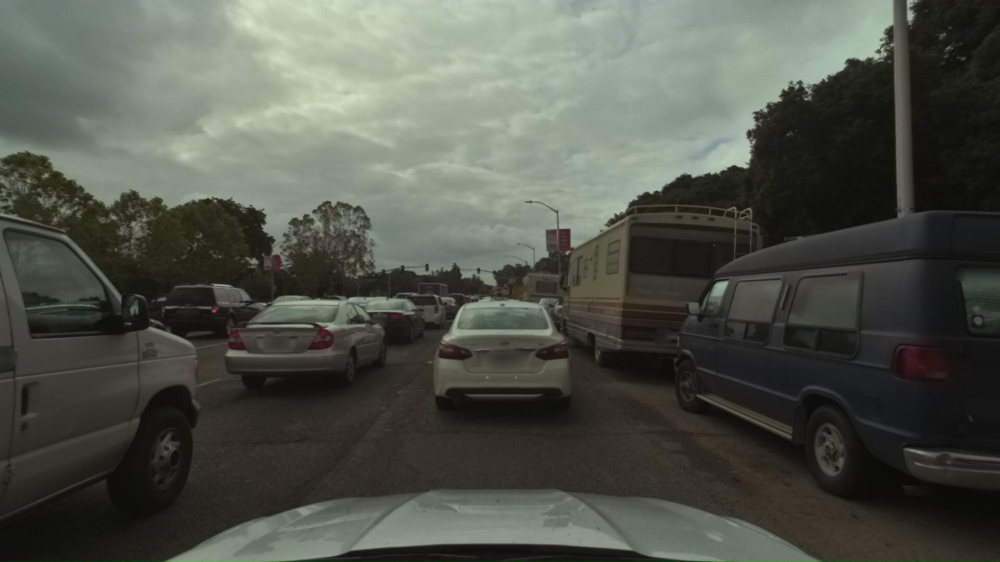

In [12]:
img = Image.open(os.path.join(data_path, cam_front['filename']))
img

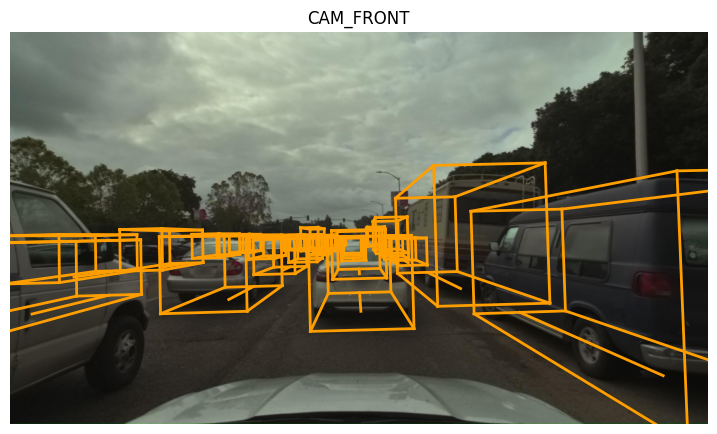

In [13]:
lyftdata.render_sample_data(cam_front['token'], with_anns=True)

### Lidar

In [14]:
lidar_top = lyftdata.get('sample_data', my_sample['data']['LIDAR_TOP']) # selecting LIDAR_TOP out of all LIDARs
lidar_top

{'is_key_frame': True,
 'prev': 'd8c2b6f50e7994c708174f077eaca66c92e7358a3cee6df32fc212b05de3c423',
 'fileformat': 'bin',
 'ego_pose_token': 'e36a9a1c02de786a9ac136640955071e1eda14659f5c75ce96b7dbc37ce52491',
 'timestamp': 1558109692502687.0,
 'next': 'a035b707c04a511ce924bdab277378a152467c778057656389eafa27875e9468',
 'token': 'f2f0d25a268a7a7112be881669bf0b4848ae591c8c70de1a8e562b81c45654d4',
 'sample_token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'filename': 'lidar/host-a101_lidar1_1242144892502687076.bin',
 'calibrated_sensor_token': '82130f5d48b806b62fec95989081337218fbf338ebcc95115d8afcebb305630c',
 'sensor_modality': 'lidar',
 'channel': 'LIDAR_TOP'}

In [15]:
lidar_filename = lidar_top['filename'].replace("/", "\\")  # Assuming lidar_top['filename'] is a string
fixed_path = data_path / lidar_filename  # This creates a Path object
pc = LidarPointCloud.from_file(fixed_path)

In [16]:
pc.points.shape # x, y, z, intensity

(4, 106940)

In [17]:
axes_limits = [
    [-30, 50], # X axis range
    [-30, 20], # Y axis range
    [-3, 10]   # Z axis range
]
axes_str = ['X', 'Y', 'Z']

def display_frame_statistics(lidar_points, points=0.2):
    """
    Displays statistics for a single frame. Draws 3D plot of the lidar point cloud data and point cloud
    projections to various planes.
    
    Parameters
    ----------
    lidar_points: lidar data points 
    points          : Fraction of lidar points to use. Defaults to `0.2`, e.g. 20%.
    """
    
    points_step = int(1. / points)
    point_size = 0.01 * (1. / points)
    pc_range = range(0, lidar_points.shape[1], points_step)
    pc_frame = lidar_points[:, pc_range]
    def draw_point_cloud(ax, title, axes=[0, 1, 2]):
        """Convenient method for drawing various point cloud projections as a part of frame statistics"""
        ax.set_facecolor('black')
        ax.grid(False)
        ax.scatter(*pc_frame[axes, :], s=point_size, c='white', cmap='grey')
        if len(axes) == 3: # 3D configs
            text_color = 'white'
            ax.set_xlim3d([-10, 30])
            ax.set_ylim3d(*axes_limits[axes[1]])
            ax.set_zlim3d(*axes_limits[axes[2]])
            ax.set_zlabel('{} axis'.format(axes_str[axes[2]]), color='white')
        else: # 2D configs
            text_color = 'black' # the `figure` is white
            ax.set_xlim(*axes_limits[axes[0]])
            ax.set_ylim(*axes_limits[axes[1]])
        ax.set_title(title, color=text_color)
        ax.set_xlabel('{} axis'.format(axes_str[axes[0]]), color=text_color)
        ax.set_ylabel('{} axis'.format(axes_str[axes[1]]), color=text_color)
            
    # Draw point cloud data as 3D plot
    f2 = plt.figure(figsize=(15, 8))
    ax2 = f2.add_subplot(111, projection='3d')
    # make the panes transparent
    ax2.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax2.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax2.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    draw_point_cloud(ax2, '3D plot')
    
    plt.show()
    plt.close(f2)
    # Draw point cloud data as plane projections
    f, ax3 = plt.subplots(3, 1, figsize=(15, 25))
#     f.set_facecolor('black')
    draw_point_cloud(
        ax3[0], 
        'XZ projection (Y = 0)', #, the car is moving in direction left to right', ?
        axes=[0, 2] # X and Z axes
    )
    draw_point_cloud(
        ax3[1], 
        'XY projection (Z = 0)', #, the car is moving in direction left to right',? 
        axes=[0, 1] # X and Y axes
    )
    draw_point_cloud(
        ax3[2], 
        'YZ projection (X = 0)', #, the car is moving towards the graph plane', ?
        axes=[1, 2] # Y and Z axes
    )
    plt.show()
    plt.close(f)

C:\Users\stern\AppData\Local\Temp\ipykernel_3176\1698236887.py:27: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(*pc_frame[axes, :], s=point_size, c='white', cmap='grey')


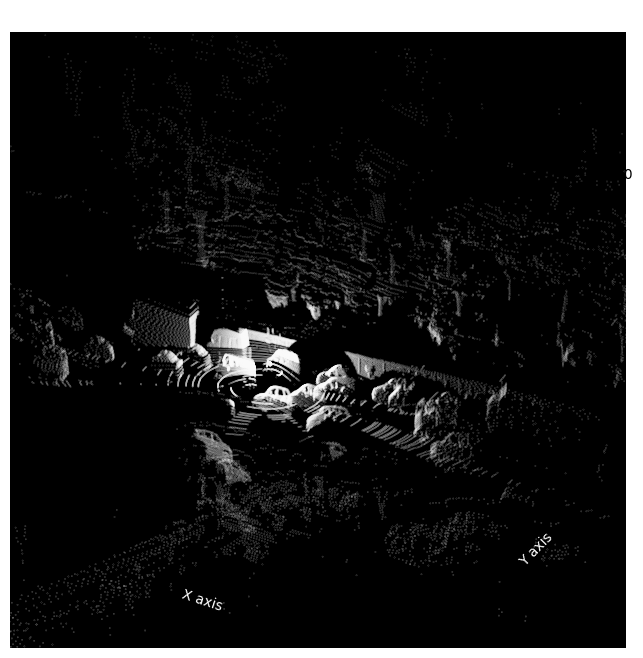

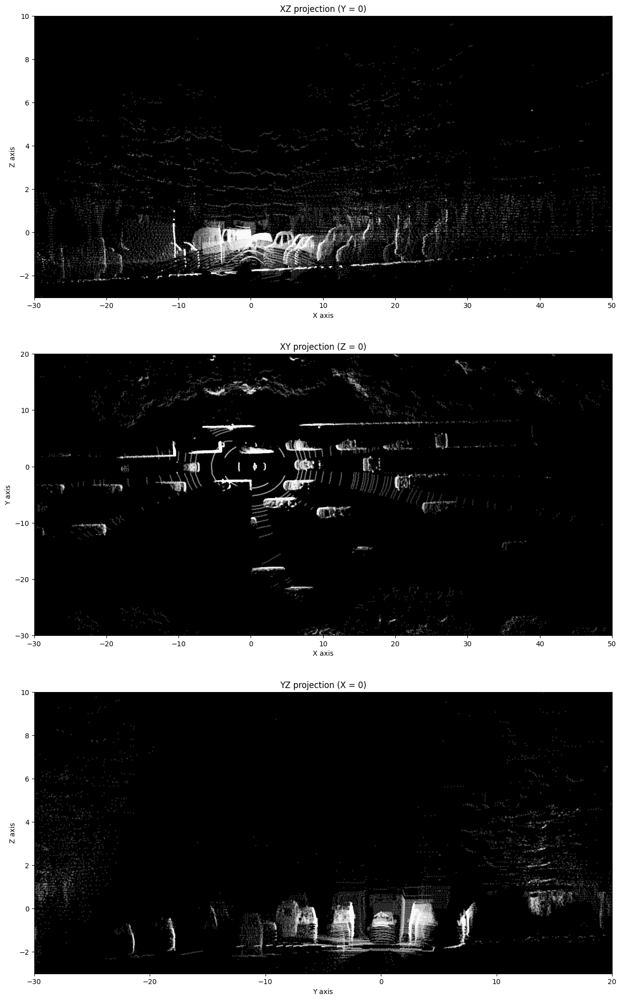

In [18]:
display_frame_statistics(pc.points, points=0.5)

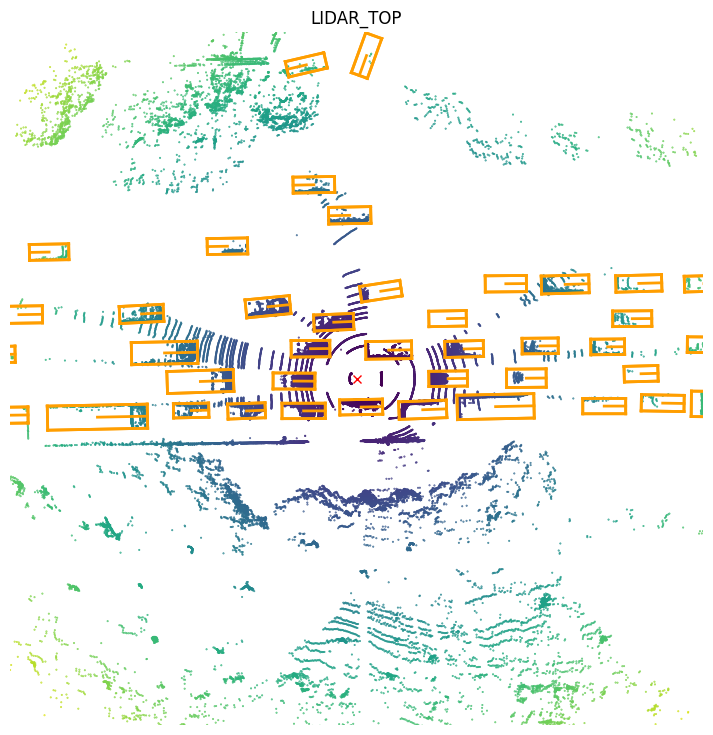

In [19]:
lyftdata.render_sample_data(lidar_top['token'], with_anns=True)

## Annotations

In [20]:
my_annotation = lyftdata.get("sample_annotation", my_sample["anns"][0])
my_annotation_token = my_annotation['token']
my_annotation_instance_token = my_annotation['instance_token']
my_annotation

{'token': '92bff46db1dbfc9679edc8091770c4256ac3c027e9f0a9c31dfc4fff41f6f677',
 'num_lidar_pts': -1,
 'size': [2.064, 5.488, 2.053],
 'sample_token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'rotation': [0.265491936795379, 0, 0, 0.964113080243515],
 'prev': 'db2c5aea69d8be40a746c5f3df9366e030189b07647212f338b31240c15896df',
 'translation': [2680.2830359778527, 698.1969292852777, -18.04776692365821],
 'num_radar_pts': 0,
 'attribute_tokens': ['1ba8c9a8bda54423fa710b0af1441d849ecca8ed7b7f9393ba1794afe4aa6aa2',
  'daf16a3f6499553cc5e1df4a456de5ee46e2e6b06544686d918dfb1ddb088f6f'],
 'next': '33e07b849d62718279c9548fe662d32247e319f0451cd461059305c3e42dcea0',
 'instance_token': 'abea2eb040d9c8fa1a44fa54020daaf9e2aa696e95e1d257481ecbf6e13a318c',
 'visibility_token': '',
 'category_name': 'car'}

In [21]:
my_box = lyftdata.get_box(my_annotation['token'])
my_box # Box class instance

label: nan, score: nan, xyz: [2680.28, 698.20, -18.05], wlh: [2.06, 5.49, 2.05], rot axis: [0.00, 0.00, 1.00], ang(degrees): 149.21, ang(rad): 2.60, vel: nan, nan, nan, name: car, token: 92bff46db1dbfc9679edc8091770c4256ac3c027e9f0a9c31dfc4fff41f6f677

In [22]:
my_box.center, my_box.wlh # center coordinates + width, length and height

(array([2680.28303598,  698.19692929,  -18.04776692]),
 array([2.064, 5.488, 2.053]))

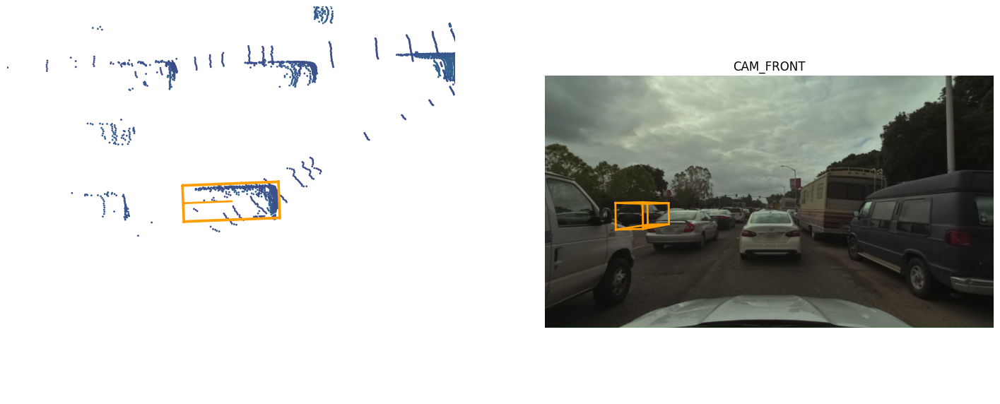

In [23]:
lyftdata.render_annotation(my_annotation['token'], margin=10)

## Attributes (each annotation has one)

In [24]:
my_attribute1 = lyftdata.get('attribute', my_annotation['attribute_tokens'][0])
my_attribute2 = lyftdata.get('attribute', my_annotation['attribute_tokens'][1])
my_attribute1

{'description': '',
 'token': '1ba8c9a8bda54423fa710b0af1441d849ecca8ed7b7f9393ba1794afe4aa6aa2',
 'name': 'object_action_stopped'}

In [25]:
my_attribute2

{'description': '',
 'token': 'daf16a3f6499553cc5e1df4a456de5ee46e2e6b06544686d918dfb1ddb088f6f',
 'name': 'is_stationary'}

## Instances. Object instance are instances that need to be detected or tracked by an autonomous vehicle (e.g a particular vehicle, pedestrian)

In [26]:
my_instance = lyftdata.get('instance', my_annotation['instance_token'])
my_instance

{'category_token': '8eccddb83fa7f8f992b2500f2ad658f65c9095588f3bc0ae338d97aff2dbcb9c',
 'last_annotation_token': '1b7d368056d75ac9082d30c84a4ffc2468cccc960aad11f1c171ec66390c8fff',
 'token': 'abea2eb040d9c8fa1a44fa54020daaf9e2aa696e95e1d257481ecbf6e13a318c',
 'first_annotation_token': '754eca53d8bce9fdc0da74ed71b35f83690bb8a8c8d5fa8e8d22d9d68031af33',
 'nbr_annotations': 100}

In [27]:
my_instance_cat = lyftdata.get("category", my_instance["category_token"])
my_instance_cat

{'description': '',
 'token': '8eccddb83fa7f8f992b2500f2ad658f65c9095588f3bc0ae338d97aff2dbcb9c',
 'name': 'car'}

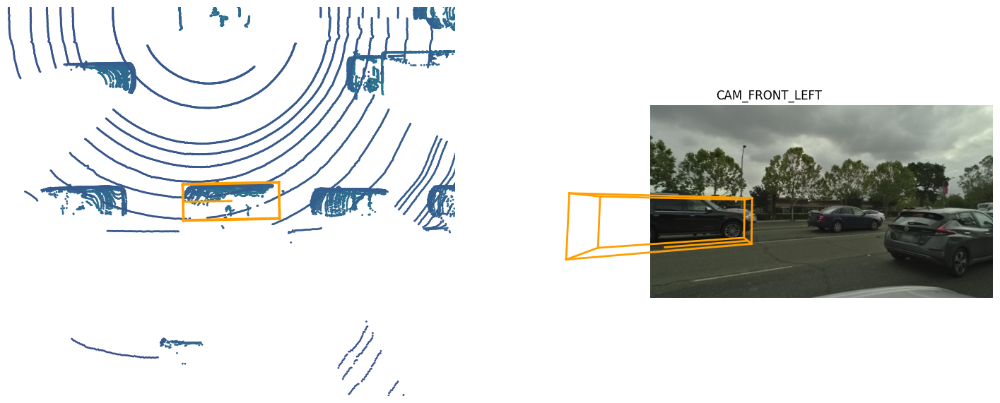

In [28]:
lyftdata.render_instance(my_instance['token'])

First annotated sample of this instance:


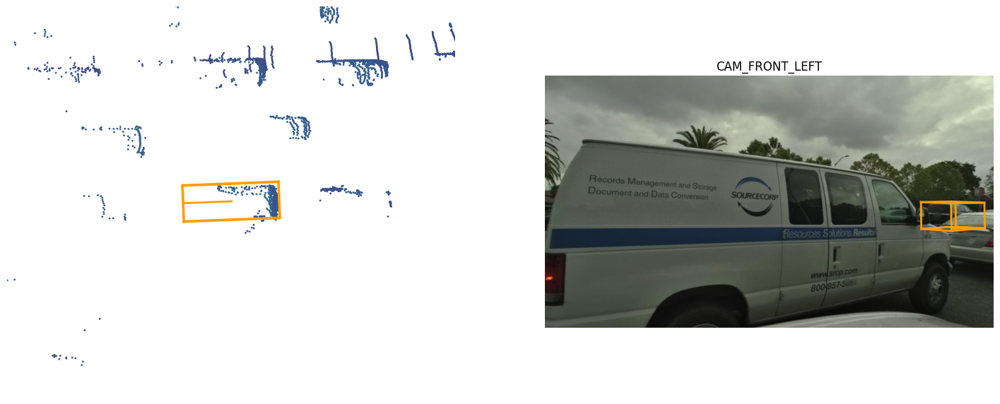

In [29]:
print("First annotated sample of this instance:")
lyftdata.render_annotation(my_instance['first_annotation_token'])

Last annotated sample of this instance


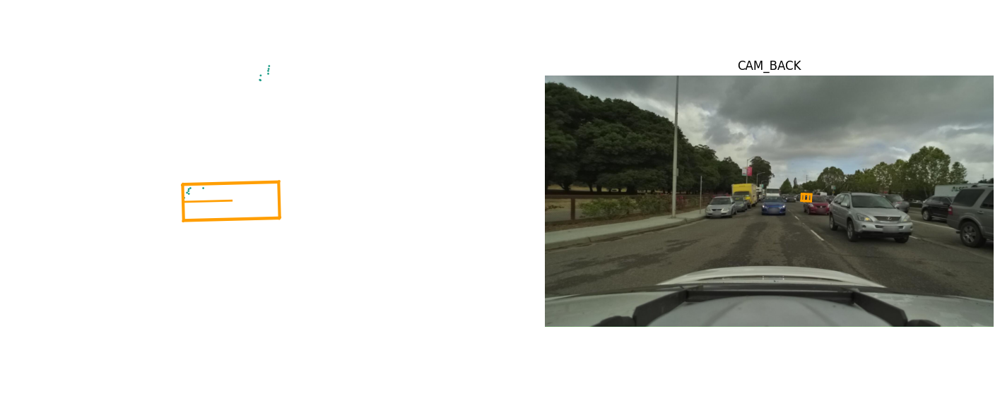

In [30]:
print("Last annotated sample of this instance")
lyftdata.render_annotation(my_instance['last_annotation_token'])

## Wrap Up

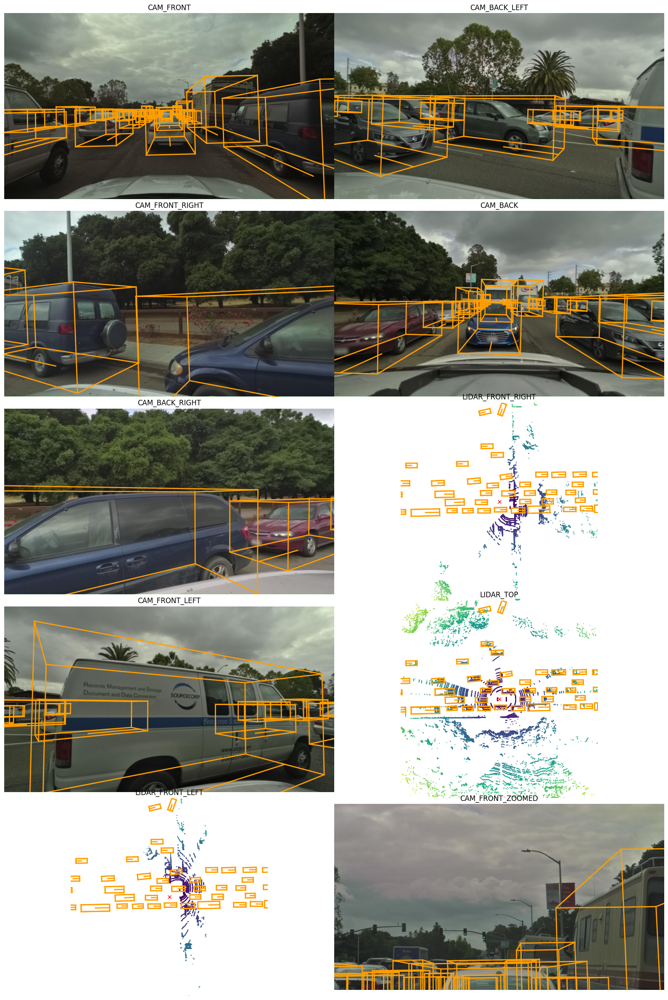

In [31]:
lyftdata.render_sample(token0)

# Personal Work begin

In [32]:
# Load the entire JSON file into a DataFrame
# test_sample_data = pd.read_json(r'S:\MADS\Capstone\3d-object-detection-for-autonomous-vehicles\test_data\sample_data.json')

# # If your JSON file has nested data, you may need to normalize it:
# # Load the JSON data
# with open('path_to_your_file.json') as file:
#     data = json.load(file)

# # If your JSON has a nested structure, you'll need to specify the record path
# test_sample_data = json_normalize(data, record_path=['path', 'to', 'nested', 'data'])

# # If you just need to normalize the top level of a nested list within the JSON:
# test_sample_data = json_normalize(data)

# # If your nested JSON includes records that themselves contain nested data:
# test_sample_data = json_normalize(data, 'nested_field', ['field1', 'field2', ['nested', 'field3']])

# # Here 'nested_field' is the path to the list of records,
# # and the list ['field1', 'field2', ['nested', 'field3']] specifies additional metadata fields to include.
# test_sample_data.head()


## Break out individual hits for each sample ID

In [33]:
regex = r"(?:\S+\s){7}[a-zA-Z]+"

# Use NumPy to broadcast the regex operation over the entire 'PredictionString' column
# This creates an array of lists of matches
matches = [re.findall(regex, s) for s in train['PredictionString']]

In [34]:
# Flatten the list of matches and create an array with corresponding ids
# The use of NumPy's repeat function aids in aligning ids with matches
flat_matches = [item for sublist in matches for item in sublist]
repeated_ids = np.repeat(train['Id'].values, [len(match) for match in matches])

In [35]:
# Now we split each match into its components and create a 2D NumPy array
split_data = np.array([m.split() for m in flat_matches])

In [36]:
# Finally, create a DataFrame from the 2D array
new_df = pd.DataFrame(split_data, columns=['center_x', 'center_y', 'center_z', 'width', 'length', 'height', 'yaw', 'class_name'])

# Convert the numeric columns to the correct dtype
numeric_cols = ['center_x', 'center_y', 'center_z', 'width', 'length', 'height', 'yaw']
new_df[numeric_cols] = new_df[numeric_cols].astype(float)

# Add the 'Id' column from the repeated_ids array
new_df['Id'] = repeated_ids

# Reorder the DataFrame if necessary
new_df = new_df[['Id', 'center_x', 'center_y', 'center_z', 'width', 'length', 'height', 'yaw', 'class_name']]
print(new_df.shape)

(638179, 9)


In [37]:
new_df.head()

,Id,center_x,center_y,center_z,width,length,height,yaw,class_name
0,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341,2680.283036,698.196929,-18.047767,2.064,5.488,2.053,2.604164,car
1,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341,2691.997462,660.801654,-18.674259,1.818,4.570,1.608,-0.335176,car
2,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341,2713.607501,694.403481,-18.589972,1.779,4.992,1.620,2.579456,car
3,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341,2679.986917,706.910150,-18.349594,1.798,3.903,1.722,2.586166,car
4,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341,2659.352096,719.417462,-18.442999,1.936,4.427,1.921,2.601799,car


In [38]:
new_df["class_name"].value_counts()

class_name
car           534911
other          33376
pedestrian     24935
bicycle        20928
truck          14164
bus             8729
motorcycle       818
animal           186
emergency        132
Name: count, dtype: int64

## Select image data with only motorcycles

In [39]:
anns = lyftdata.sample_annotation
moto_anns = [d for d in anns if d["category_name"] == "motorcycle"]
moto_anns

[{'token': '125078a588455bef113ec114b1d6dea4d997d141ea993eabcd55374b2dc0ef98',
  'num_lidar_pts': -1,
  'size': [0.932, 2.612, 1.513],
  'sample_token': '24ddb4f7911431a3af89b5443e665bbb046ed8df558392e100316ab67eb99e05',
  'rotation': [-0.514479130914882, 0, 0, 0.8575029002009659],
  'prev': 'c1a298e859b156599d51158db18b2ee5adde9a6553cd6723aeb4669a9860a6db',
  'translation': [2685.2672961296166, 711.5967397784807, -18.772381176661092],
  'num_radar_pts': 0,
  'attribute_tokens': ['5466ded30df08d7d825412ac907017d6ae00ff19051c63666de3dcc4a535c8cc',
   'daf16a3f6499553cc5e1df4a456de5ee46e2e6b06544686d918dfb1ddb088f6f'],
  'next': '185a918f06d94faef4b139d56488115856419b4fe644f6e3671ebbd8f3588454',
  'instance_token': 'f2a1b2fb2f304525b769ef44dca92b1fada68dbf7ad183ad30ee4097732cbc8b',
  'visibility_token': '',
  'category_name': 'motorcycle'},
 {'token': '19cba4984d8537a86f952a2eed63d81b6d6ac02009c5713309090b7be7f17c84',
  'num_lidar_pts': -1,
  'size': [0.942, 2.168, 1.665],
  'sample_toke

In [40]:
print(len(moto_anns))
moto_anns[1]

818


{'token': '19cba4984d8537a86f952a2eed63d81b6d6ac02009c5713309090b7be7f17c84',
 'num_lidar_pts': -1,
 'size': [0.942, 2.168, 1.665],
 'sample_token': 'decbf008e52aae639da0c362c039e60c54eff3896be7734a68bb4985177f11ce',
 'rotation': [0.5210770725560203, 0, 0, 0.8535096276296172],
 'prev': 'e1d231429677b25008746b73d5006fac241bfb87ac970644822bfdded379b45f',
 'translation': [1021.0289318176875, 1735.9640414121147, -23.878991348872454],
 'num_radar_pts': 0,
 'attribute_tokens': ['5466ded30df08d7d825412ac907017d6ae00ff19051c63666de3dcc4a535c8cc',
  'daf16a3f6499553cc5e1df4a456de5ee46e2e6b06544686d918dfb1ddb088f6f'],
 'next': '6edc66865f123a51e018ffc70e4a34236e20b4b1bf284a276e7d929d0655c71b',
 'instance_token': 'ec8f8e3ee61e6e540b64066cd30345166dff882d60f3f74e64661f27a9c1cece',
 'visibility_token': '',
 'category_name': 'motorcycle'}

In [63]:
from lyft_dataset_sdk.utils import data_classes
data_classes.Box

lyft_dataset_sdk.utils.data_classes.Box

In [53]:
#In order to find the image files that contain our moto_anns, we must do the following:
#Accumulate the superset of Samples that contain all of our moto_annotations
def img_class_selector(class_name, box_visibility = BoxVisibility.ALL):
    """
    There wasn't a super clean way in the API to select image files that contain annotations from x class. I adapted the method they use in their .render_annotation() method.

    Returns tuples of (file_path, Box object (lyft_dataset_sdk.utils.data_classes.Box))
    """

    annos_class = lyftdata.sample_annotation
    moto_anns = [d for d in annos_class if d["category_name"] == class_name]
    sample_moto_tokens = set()
    for ann in moto_anns:
        sample_moto_tokens.add(ann["sample_token"])

    moto_images_boxes = []
    for sample_token in sample_moto_tokens:
        sample_record = lyftdata.get("sample", sample_token)
        sample_anns = sample_record["anns"]
        cams = [key for key in sample_record["data"].keys() if "CAM" in key]
        
        #We unfortunately do have to iterate through each annotation that exists within the sample_record. There typically aren't more than 20-30 or so.
        for ann in sample_anns:
            # Figure out which camera the object is fully visible in (this may return nothing)
            for cam in cams:
                path, box, _ = lyftdata.get_sample_data(sample_record["data"][cam], box_vis_level=box_visibility, selected_anntokens=[ann])
                if box:
                    if box[0].name == class_name:
                        moto_images_boxes.append((str(path), box[0]))

moto_images = img_class_selector()

962


[('S:\\MADS\\Capstone\\3d-object-detection-for-autonomous-vehicles\\images\\host-a007_cam4_1232470072684150006.jpeg',
  label: nan, score: nan, xyz: [22.12, 2.39, 51.32], wlh: [0.58, 2.19, 1.26], rot axis: [-0.80, -0.44, 0.40], ang(degrees): -100.80, ang(rad): -1.76, vel: nan, nan, nan, name: motorcycle, token: e9d302100df000d3b3fb84c8a9875a80ac67b8b96f4f705077daa52dd572ad3b),
 ('S:\\MADS\\Capstone\\3d-object-detection-for-autonomous-vehicles\\images\\host-a011_cam0_1235933785951142006.jpeg',
  label: nan, score: nan, xyz: [-26.15, 2.63, 67.00], wlh: [1.04, 2.65, 1.45], rot axis: [-1.00, -0.00, 0.04], ang(degrees): -89.47, ang(rad): -1.56, vel: nan, nan, nan, name: motorcycle, token: 5d30c2d55927204c6681163e5b08569f464ce265c4953d0f27cdf2ac748887ff),
 ('S:\\MADS\\Capstone\\3d-object-detection-for-autonomous-vehicles\\images\\host-a011_cam4_1235933792184485006.jpeg',
  label: nan, score: nan, xyz: [1.66, 1.60, 29.39], wlh: [1.04, 2.65, 1.45], rot axis: [0.35, 0.66, -0.67], ang(degrees): 

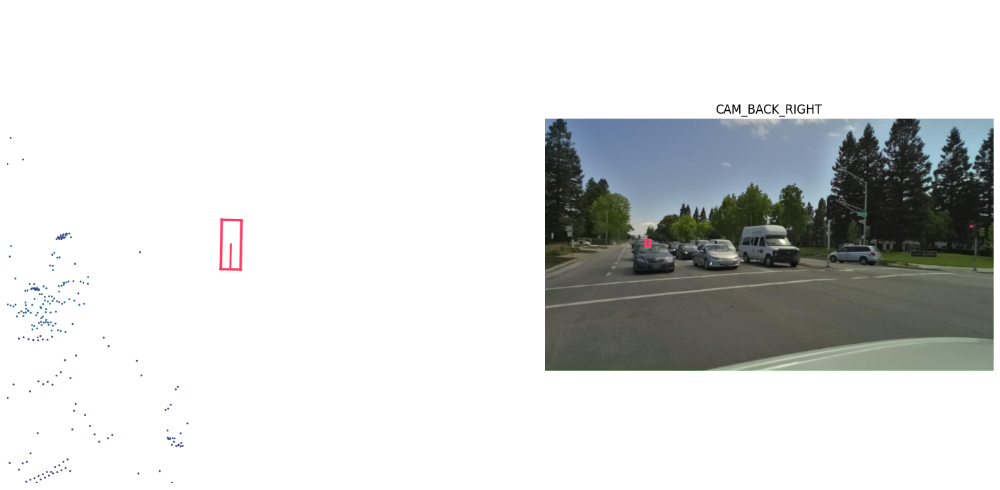

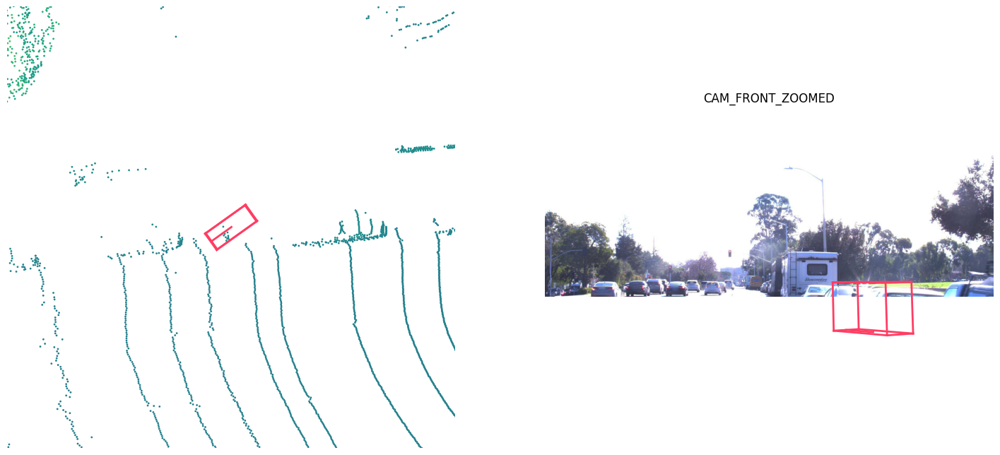

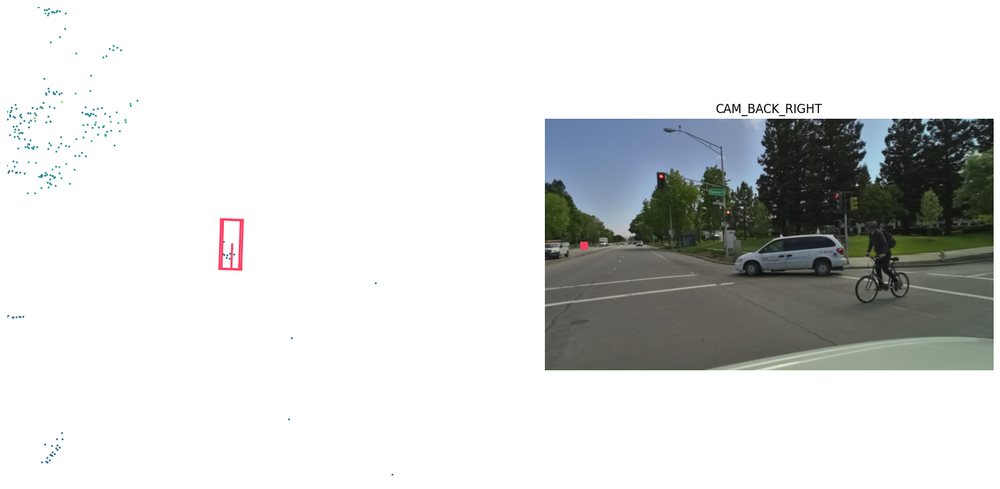

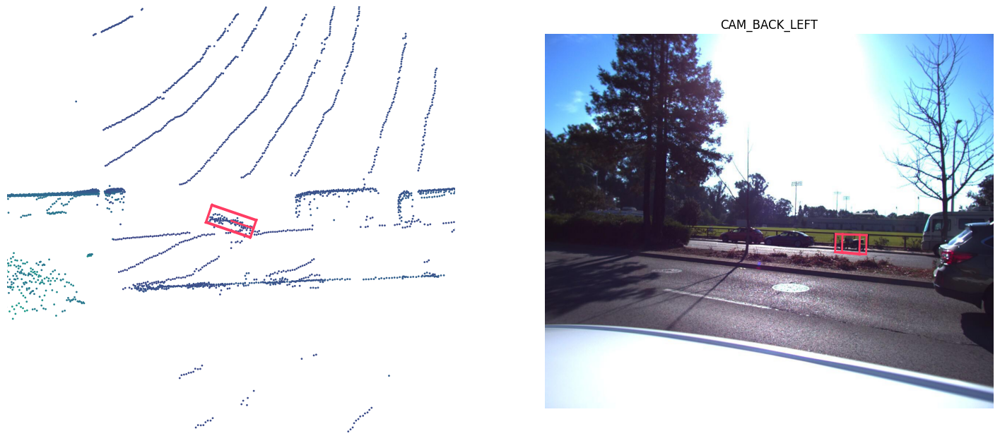

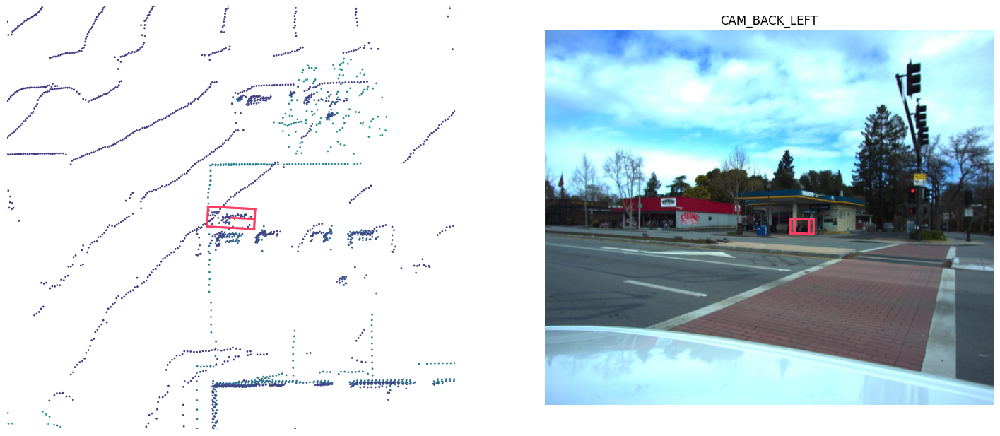

...

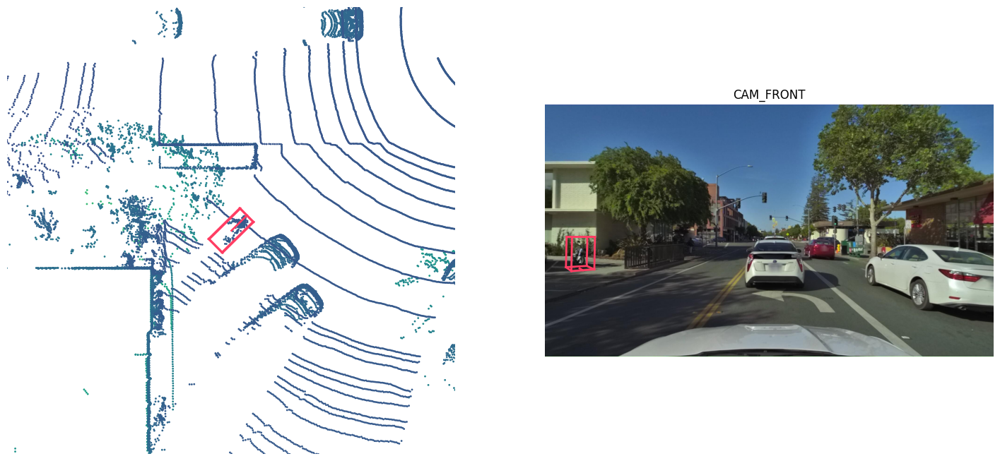

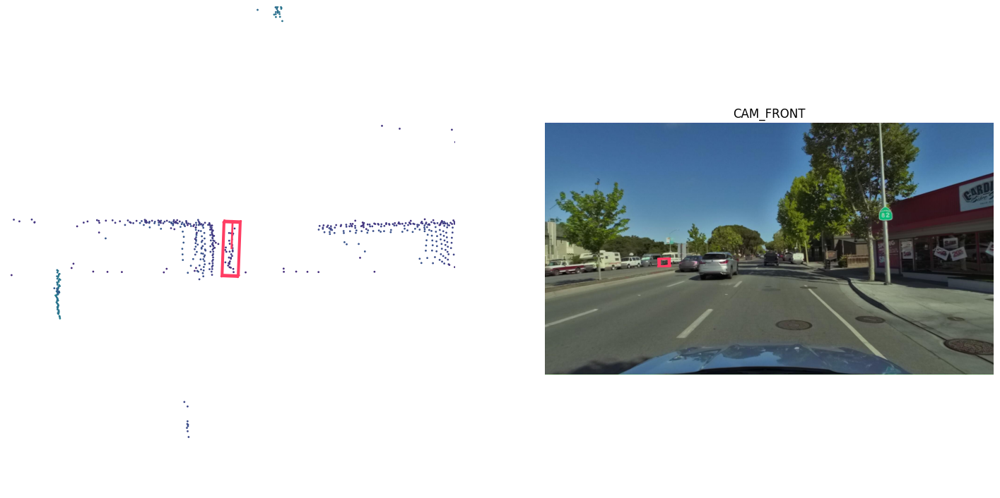

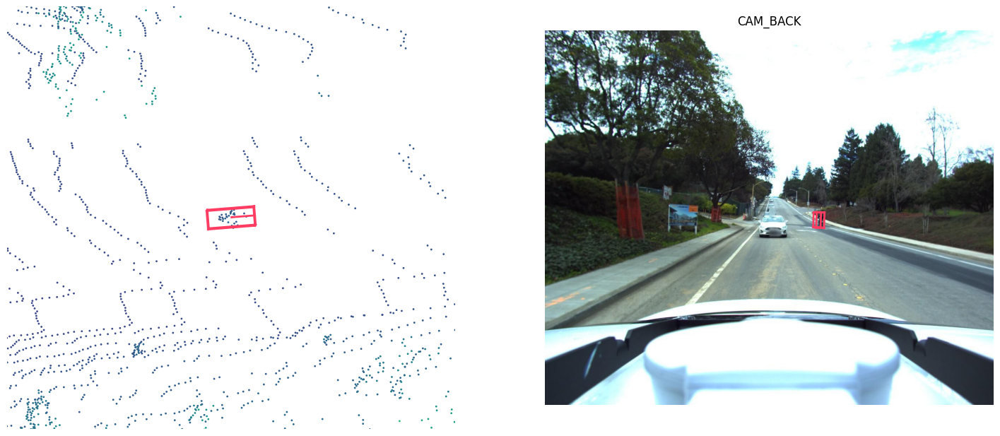

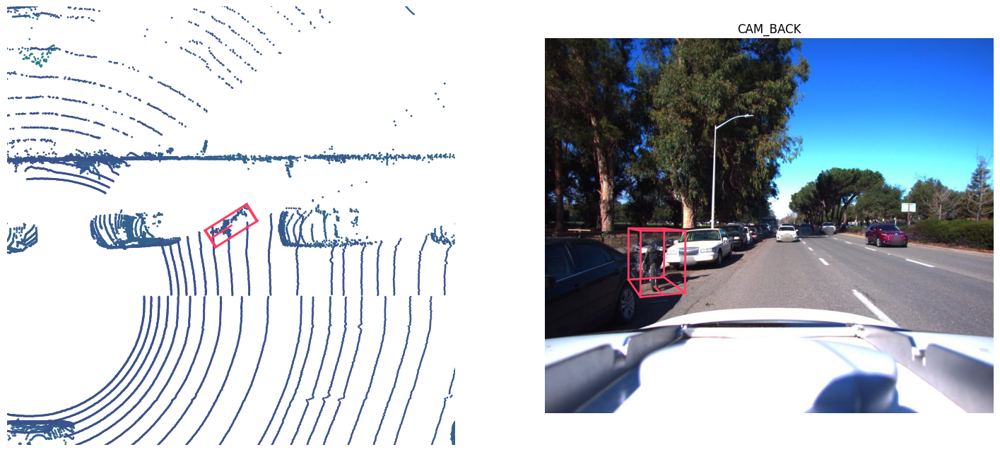

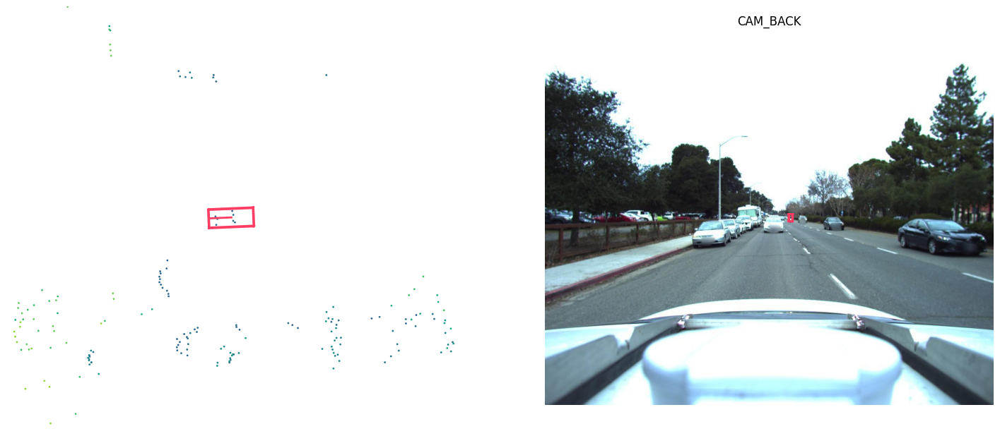

In [59]:
#Look at 20 moto sample images
subset_moto = random.sample(moto_images_boxes, 20)

for vals in subset_moto:
    lyftdata.render_annotation(vals[1].token)


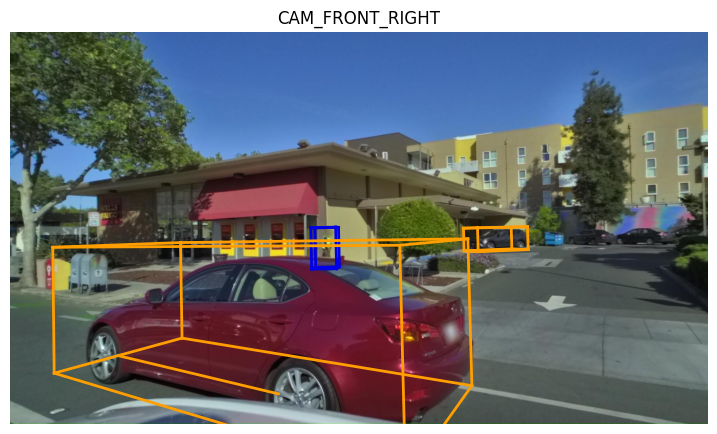

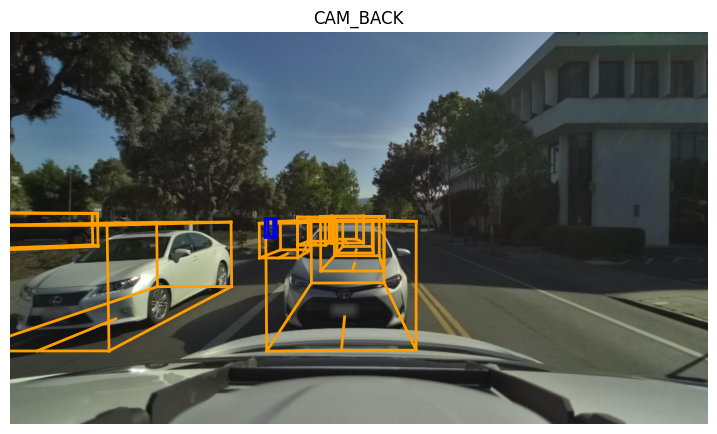

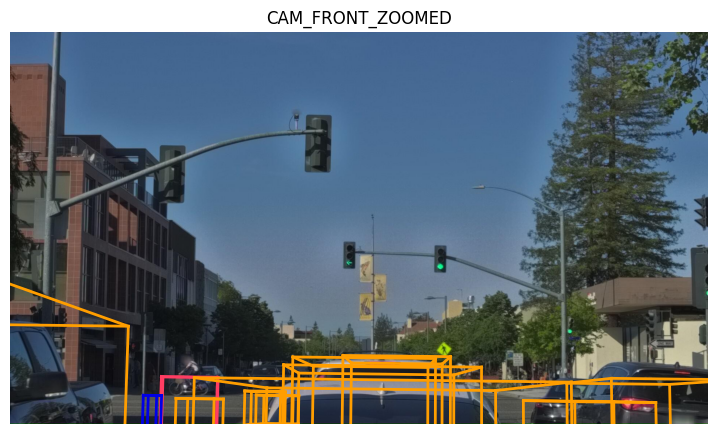

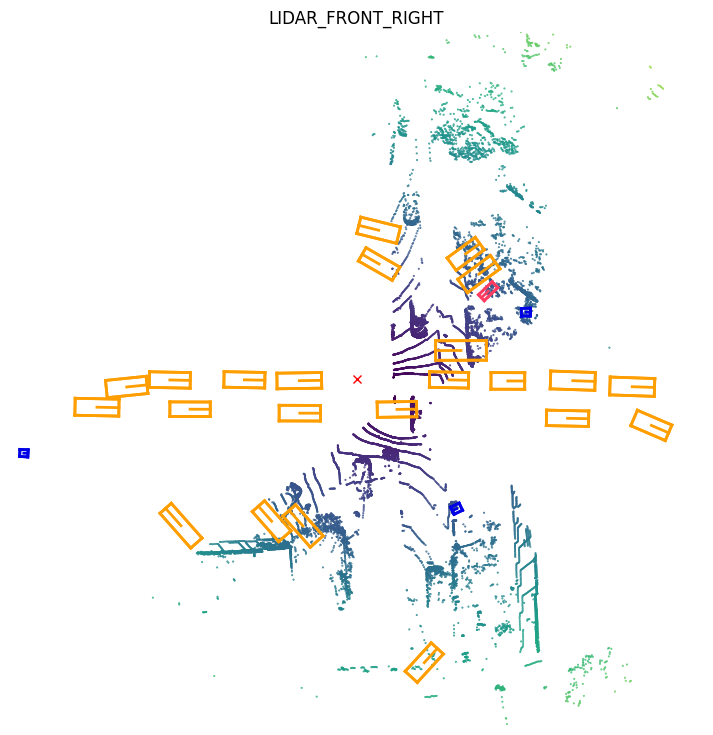

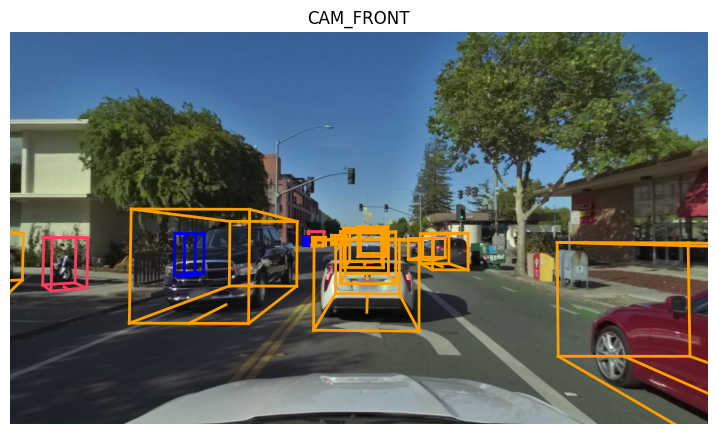

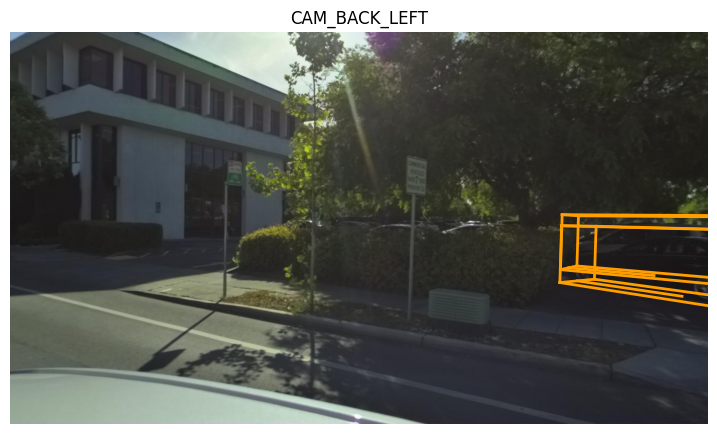

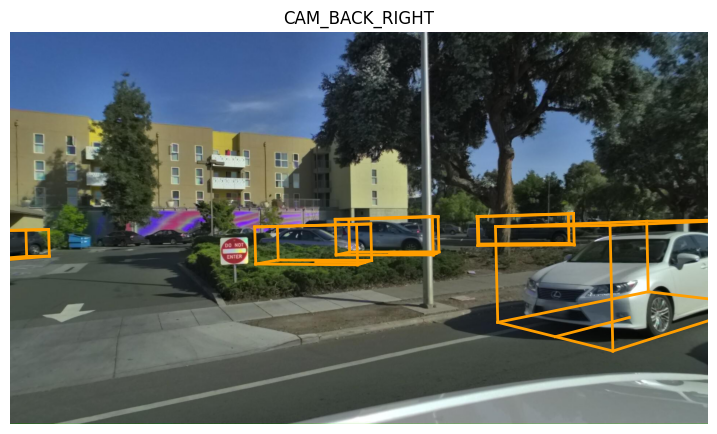

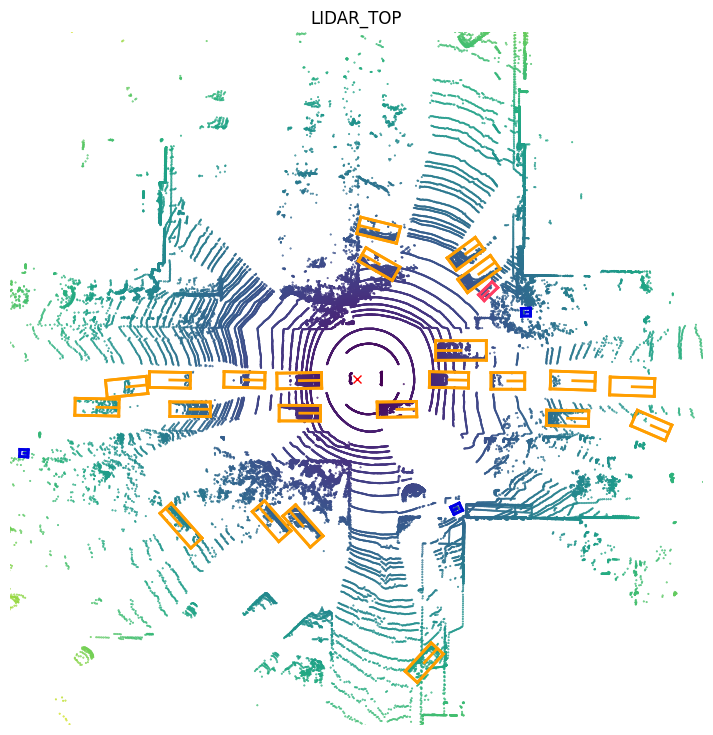

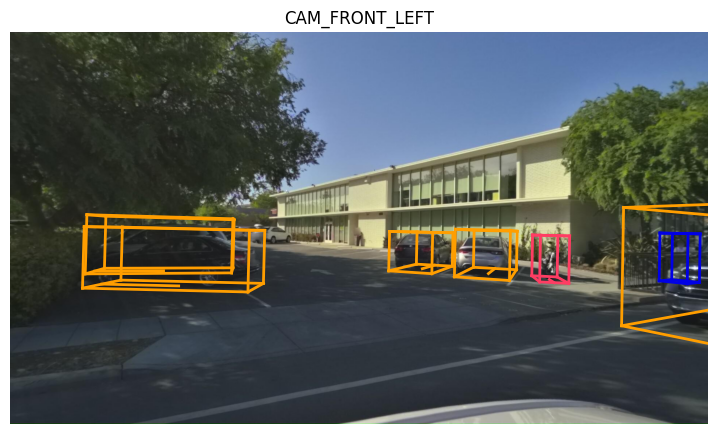

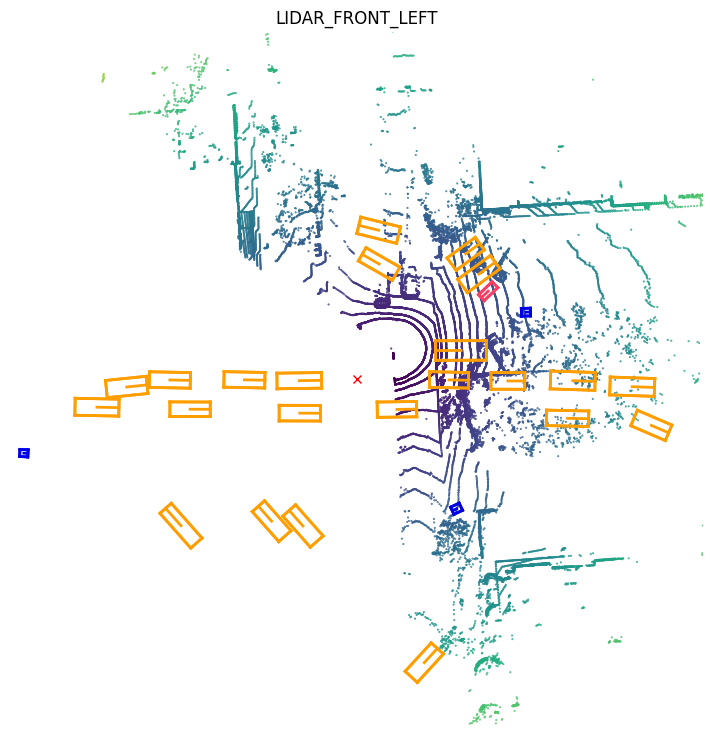

In [80]:
#Samples_with_moto = set()
#For each ann in moto anns:
    #Get the sample token for that ann and put it in the set
#For each sample_with_moto:
    #For each sensor sample_data:


sensor_tokens = lyftdata.get("sample", moto_anns[1]["sample_token"])["data"]
sensor_tokens

for k, v in sensor_tokens.items():

    sensor_k = lyftdata.get("sample_data", sensor_tokens[k])
    moto_anns = 
    lyftdata.render_sample_data(sensor_k["token"])

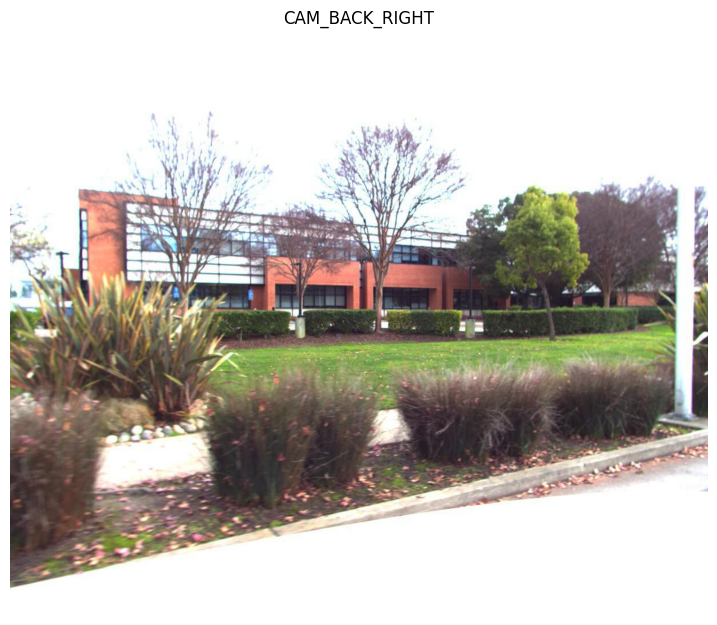

In [75]:
lyftdata.render_sample_data(sensor_tokens["CAM_BACK_RIGHT"], with_anns = True)
# Image.open(os.path.join(data_path, cam_back_right['filename']))

Help on class NoneType in module builtins:

class NoneType(object)
 |  Methods defined here:
 |  
 |  __bool__(self, /)
 |      True if self else False
 |  
 |  __repr__(self, /)
 |      Return repr(self).
 |  
 |  ----------------------------------------------------------------------
 |  Static methods defined here:
 |  
 |  __new__(*args, **kwargs) from builtins.type
 |      Create and return a new object.  See help(type) for accurate signature.



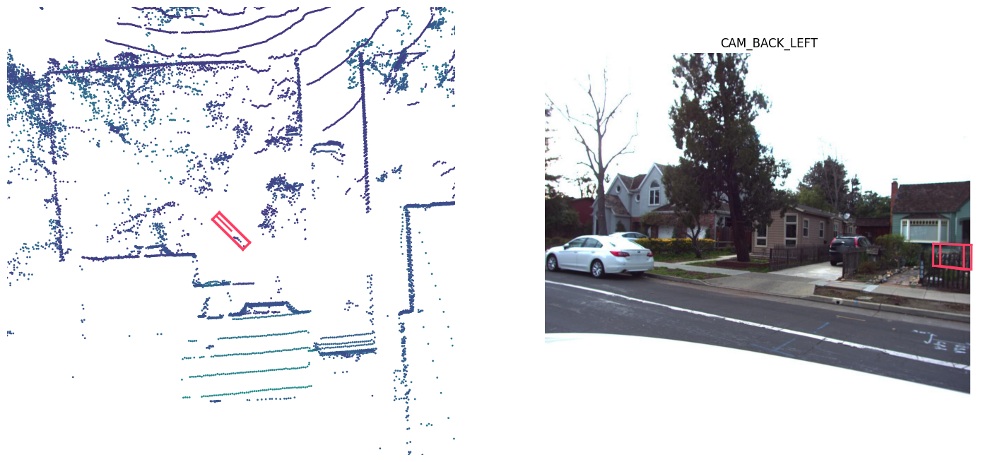

In [87]:
help(type(lyftdata.render_annotation(moto_anns[7]["token"])))


## Create Custom Dataset class to load the Lyft data into a Pytorch object

In [39]:
class CustomImageDataset(Dataset):
    def __init__(self, annotations_file, img_dir, img_class, transform=None, target_transform=None):
        self.img_labels = pd.read_csv(annotations_file)
        self.img_dir = img_dir
        self.transform = transform
        self.target_transform = target_transform

    def __len__(self):
        return len(self.img_labels)

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.img_labels.iloc[idx, 0])
        image = read_image(img_path)
        label = self.img_labels.iloc[idx, 1]
        if self.transform:
            image = self.transform(image)
        if self.target_transform:
            label = self.target_transform(label)
        return image, label

In [40]:
help(torchvision)

Help on package torchvision:

NAME
    torchvision

PACKAGE CONTENTS
    _C
    _internally_replaced_utils
    _meta_registrations
    _utils
    datasets (package)
    extension
    image
    io (package)
    models (package)
    ops (package)
    prototype (package)
    transforms (package)
    tv_tensors (package)
    utils
    version

FUNCTIONS
    disable_beta_transforms_warning()
    
    get_image_backend()
        Gets the name of the package used to load images
    
    get_video_backend()
        Returns the currently active video backend used to decode videos.
        
        Returns:
            str: Name of the video backend. one of {'pyav', 'video_reader'}.
    
    set_image_backend(backend)
        Specifies the package used to load images.
        
        Args:
            backend (string): Name of the image backend. one of {'PIL', 'accimage'}.
                The :mod:`accimage` package uses the Intel IPP library. It is
                generally faster than PIL, bu